# Clustering the genres into groups

This file explores attributes of the documents -> genres of GUM and performs a cluster analysis on them to produce homogeneous groups according to the distribution of these attributes.

Contents:
- 00) Setup
- 01) Get the file paths
- 02) Get data and collect EDU level information
- 03) Aggregate information on document level
- 04) Aggregate information on genre level, standardize numeric columns and reduce dimensions
- 05) Cluster genres

## 0. Setup

### 0.a Load necessary libraries

In [34]:
import random
import os
from nltk.corpus import stopwords
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.manifold import TSNE
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.cluster import SpectralClustering
from sklearn.mixture import GaussianMixture
from scipy.cluster.hierarchy import dendrogram, linkage

### 0.b Set seeds and get stopwords

In [35]:
np.random.seed(42)
random.seed(42)

stop_words = set(stopwords.words('english'))

## 1. Get the file paths

In [41]:
def list_rsd_file_paths(directory): 
    
    try: 
        # Get all file names in the specified directory 
        file_names = os.listdir(directory) 

        # Make sure to only capture .rsd files
        rs4_file_paths = [directory + '/' + file for file in file_names if file.endswith('.rsd')] 

        return rs4_file_paths 

    # Error handling
    except Exception as e: 

        print(f'An error occurred: {e}') 

        return [] 


# Get all rsd files in the train + dev + test file folders
rsd_file_paths = list_rsd_file_paths('C:/Users/marco/OneDrive/24_25_WS/Discourse_modeling_and_processing/disco-project/data/train') + list_rsd_file_paths('C:/Users/marco/OneDrive/24_25_WS/Discourse_modeling_and_processing/disco-project/data/test') + list_rsd_file_paths('C:/Users/marco/OneDrive/24_25_WS/Discourse_modeling_and_processing/disco-project/data/dev')

## 2. Get data and aggregate collect EDU level information

### 2.a Go through all genres and documents and extract relevant information on EDU level

In [45]:
def rsd_file_paths_to_dict(rsd_file_paths):
    
    # Dictionary structure: 
    # Highest layer key = genre
    # Second layer key = document
    genre_document_dict = {
        'academic':{},
        'bio':{},
        'conversation':{},
        'court':{},
        'essay':{},
        'fiction':{},
        'interview':{},
        'letter':{},
        'news':{},
        'podcast':{},
        'reddit':{},
        'speech':{},
        'textbook':{},
        'vlog':{},
        'whow':{},
        'voyage':{}
    }

    for file_path in rsd_file_paths:

        ids = []
        texts = []
        additionals = []
        parents = []
        relations = []
        markers = []

        with open(file_path, 'r', encoding='utf-8') as file: 
            for line in file:

                row = line.split('\t')

                try:
                    ids.append(int(row[0]))
                    texts.append(row[1])
                    additionals.append(row[5])
                    parents.append(int(row[6]))
                    relations.append(row[7])
                    markers.append(row[9])

                except IndexError: 
                    print(f"Skipping row with insufficient columns in file: {file_path}")
                    ids = ids[:len(markers)]
                    texts = texts[:len(markers)]
                    additionals = additionals[:len(markers)]
                    parents = parents[:len(markers)]
                    relations = relations[:len(markers)]


        # For each EDU get:
        # 0: tokenized text of EDU pair with start, separation and end marker
        # 1: text of single EDU

        # 2: fine grained label
        # 3: coarse label

        # 4: total markers
        # 5: total markers counter
        # 6: dm markers counter
        # 7: graphical markers counter
        # 8: lexical markers counter
        # 9: morphological markers counter
        # 10: numerical markers counter
        # 11: reference markers counter
        # 12: semantic markers counter
        # 13: syntactic markers counter

        # 14: Additional information
        # 15: Sentence type
        # 16: EDU tense
        # 17: EDU tense coarse

        # 18: Nuc-Sat relation
        # 19: EDU length

        edu_pairs = []
        
        for i in range(len(ids)):

            # Nuc-Sat Relations
            if relations[i][-1] == 'r' and parents[i] in ids: 
                # 0: tokenized text of EDU pair with start, separation and end marker
                edu_pair_text = ['<s>'] + texts[i].split(' ') + ['<sep>'] + texts[ids.index(parents[i])].split(' ') + ['<n>']
                # 2: fine grained label
                fine_grained_label = relations[i][:-2]
                # 3: coarse label
                coarse_label = relations[i][:relations[i].rfind('-')] if relations[i].find('same') else relations[i][:-2]
                # 18: Nuc-Sat relation
                nuc_sat_rel = 1
                # 19: EDU length
                edu_length = len(texts[i].split(' '))

            # Multinuclear   
            elif relations[i][-1] == 'm' and parents[i] in ids: 
                # 0: tokenized text of EDU pair with start, separation and end marker
                edu_pair_text = ['<n>'] + texts[i].split(' ') + ['<sep>'] + texts[ids.index(parents[i])].split(' ') + ['<n>']
                # 2: fine grained label
                fine_grained_label = relations[i][:-2]
                # 3: coarse label
                coarse_label = relations[i][:relations[i].rfind('-')] if relations[i].find('same') else relations[i][:-2]
                # 18: Nuc-Sat relation
                nuc_sat_rel = 0
                # 19: EDU length
                edu_length = len(texts[i].split(' '))

            # Parent is Root
            else: 
                # 0: tokenized text of EDU pair with start, separation and end marker (ROOT!)
                edu_pair_text = None
                # 2: fine grained label
                fine_grained_label = relations[i]
                # 3: coarse label
                coarse_label = relations[i]
                # 18: Nuc-Sat relation
                nuc_sat_rel = -1
                # 19: EDU length
                edu_length = len(texts[i].split(' '))

  
            # 4-13: discourse marker information
            edu_markers = markers[i].split(';') if markers[i].find('_') else []
            edu_markers_dm = [marker for marker in edu_markers if marker[:marker.find('-')] == 'dm']
            edu_markers_graphical = [marker for marker in edu_markers if marker[:marker.find('-')] == 'graphical']
            edu_markers_lexical = [marker for marker in edu_markers if marker[:marker.find('-')] == 'lexical']
            edu_markers_morphological = [marker for marker in edu_markers if marker[:marker.find('-')] == 'morphological']
            edu_markers_numerical = [marker for marker in edu_markers if marker[:marker.find('-')] == 'numerical']
            edu_markers_reference = [marker for marker in edu_markers if marker[:marker.find('-')] == 'reference']
            edu_markers_semantic = [marker for marker in edu_markers if marker[:marker.find('-')] == 'semantic']
            edu_markers_syntactic = [marker for marker in edu_markers if marker[:marker.find('-')] == 'syntactic']

            # 14: Additional information
            additional_informations = additionals[i].split('|') if additionals[i].find('|') > 0 else []

            # 15: Sentence type information
            stype = [info[info.find('=')+1:] for info in additional_informations if not info.find('stype')][0]

            # 16: EDU tense information
            edu_tense = [info[info.find('=')+1:] for info in additional_informations if not info.find('edu_tense')][0]

            # 17: EDU tense coarse
            if edu_tense[:3] == 'Non':
                edu_tense_coarse = 'None'  
            elif edu_tense[:3] =='Mod':
                edu_tense_coarse = 'Modal'
            elif edu_tense[:3] =='Fut':
                edu_tense_coarse = 'Fut'
            else:
                edu_tense_coarse = edu_tense[:4]

                
            edu_pairs.append([
                    edu_pair_text,
                    texts[i], # 1: text of single EDU
                    fine_grained_label,
                    coarse_label,
                    edu_markers,
                    len(edu_markers),
                    len(edu_markers_dm),
                    len(edu_markers_graphical),
                    len(edu_markers_lexical),
                    len(edu_markers_morphological),
                    len(edu_markers_numerical),
                    len(edu_markers_reference),
                    len(edu_markers_semantic),
                    len(edu_markers_syntactic),
                    additional_informations,
                    stype,
                    edu_tense,
                    edu_tense_coarse,
                    nuc_sat_rel,
                    edu_length
                ])

        # Check whether it is a file path with directories or plain file names
        if file_path.find('/') >= 0:
            shortened_file_path = file_path[file_path.rfind('/')+1:]
            file_genre = shortened_file_path[shortened_file_path.find('_')+1:shortened_file_path.rfind('_')]
            file_document = shortened_file_path[shortened_file_path.rfind('_')+1:shortened_file_path.find('.')]
        else:
            file_genre = file_path[file_path.find('_')+1:file_path.rfind('_')]
            file_document = file_path[file_path.rfind('_')+1:file_path.find('.')]

        genre_document_dict[file_genre][file_document] = edu_pairs
            
    return genre_document_dict

genre_document_dict = rsd_file_paths_to_dict(rsd_file_paths)

### 2.b Explore relation labels

In [46]:
for genre in genre_document_dict.keys():
    for document in genre_document_dict[genre].keys():
        for edu_pair in genre_document_dict[genre][document]:
            print('---')
            print(edu_pair[2])
            print(edu_pair[3])

            # 2: fine grained label
            # 3: coarse label

---
organization-heading
organization
---
elaboration-additional
elaboration
---
attribution-positive
attribution
---
joint-list
joint
---
joint-list
joint
---
joint-list
joint
---
organization-preparation
organization
---
joint-list
joint
---
joint-list
joint
---
explanation-justify
explanation
---
elaboration-attribute
elaboration
---
context-background
context
---
elaboration-attribute
elaboration
---
same-unit
same-unit
---
elaboration-attribute
elaboration
---
same-unit
same-unit
---
context-background
context
---
elaboration-attribute
elaboration
---
elaboration-additional
elaboration
---
elaboration-attribute
elaboration
---
adversative-concession
adversative
---
adversative-antithesis
adversative
---
context-background
context
---
elaboration-attribute
elaboration
---
same-unit
same-unit
---
elaboration-attribute
elaboration
---
purpose-goal
purpose
---
elaboration-additional
elaboration
---
elaboration-additional
elaboration
---
purpose-goal
purpose
---
mode-means
mode
---
sam

### 2.c Explore discourse marker information

In [47]:
for genre in genre_document_dict.keys():
    for document in genre_document_dict[genre].keys():
        for edu_pair in genre_document_dict[genre][document]:
            print('---')
            print(f"Total markers: {edu_pair[4]}")
            print(f"Total markers (#): {edu_pair[5]}")
            print(f"DM markers (#): {edu_pair[6]}")
            print(f"Graphical markers (#): {edu_pair[7]}")
            print(f"Lexical markers (#): {edu_pair[8]}")
            print(f"Morphological markers (#): {edu_pair[9]}")
            print(f"Numerical markers (#): {edu_pair[10]}")
            print(f"Reference markers (#): {edu_pair[11]}")
            print(f"Semantic markers (#): {edu_pair[12]}")
            print(f"Syntactic markers (#): {edu_pair[13]}")

            # 4: total markers
            # 5: total markers counter
            # 6: dm markers counter
            # 7: graphical markers counter
            # 8: lexical markers counter
            # 9: morphological markers counter
            # 10: numerical markers counter
            # 11: reference markers counter
            # 12: semantic markers counter
            # 13: syntactic markers counter

---
Total markers: ['graphical-layout-', 'semantic-lexical_chain-4,619', 'semantic-lexical_chain-5,620\n']
Total markers (#): 3
DM markers (#): 0
Graphical markers (#): 1
Lexical markers (#): 0
Morphological markers (#): 0
Numerical markers (#): 0
Reference markers (#): 0
Semantic markers (#): 2
Syntactic markers (#): 0
---
Total markers: ['graphical-colon-6\n']
Total markers (#): 1
DM markers (#): 0
Graphical markers (#): 1
Lexical markers (#): 0
Morphological markers (#): 0
Numerical markers (#): 0
Reference markers (#): 0
Semantic markers (#): 0
Syntactic markers (#): 0
---
Total markers: ['semantic-attribution_source-12-46', 'syntactic-reported_speech-676\n']
Total markers (#): 2
DM markers (#): 0
Graphical markers (#): 0
Lexical markers (#): 0
Morphological markers (#): 0
Numerical markers (#): 0
Reference markers (#): 0
Semantic markers (#): 1
Syntactic markers (#): 1
---
Total markers: ['syntactic-parallel_syntactic_construction-12-27,29-30\n']
Total markers (#): 1
DM markers (#

In [6]:
# How did we identify the marker types

marker_types = []

for genre in genre_document_dict.keys():
    for document in genre_document_dict[genre].keys():
        for edu_pair in genre_document_dict[genre][document]:
            for marker in edu_pair[4]:
                marker_types.append(marker[:marker.find('-')])


set(marker_types)

{'dm',
 'graphical',
 'lexical',
 'morphological',
 'numerical',
 'reference',
 'semantic',
 'syntactic'}

### 2.d Explore sentence types

In [14]:
for genre in genre_document_dict.keys():
    for document in genre_document_dict[genre].keys():
        for edu_pair in genre_document_dict[genre][document]:
            print('---')
            print(f"Addtional information: {edu_pair[14]}")
            print(f"Stype: {edu_pair[15]}")


---
Syntactic information: ['pos1=JJ', 'head_tok=appreciation', 'head_pos=NN', 'head_id=2', 'parent_pos=_', 'sid=1', 'stype=frag', 'len=6', 'head_func=root', 'edu_tense=None', 'heading=heading']
Stype: frag
---
Syntactic information: ['pos1=NNS', 'head_tok=insight', 'head_pos=NNS', 'head_id=7', 'parent_pos=_', 'sid=2', 'stype=frag', 'len=5', 'head_func=root', 'edu_tense=None', 'heading=heading']
Stype: frag
---
Syntactic information: ['pos1=NP', 'head_tok=Claire', 'head_pos=NP', 'head_id=12', 'parent_pos=_', 'sid=3', 'stype=frag', 'len=11', 'head_func=root', 'edu_tense=None', 'para=para']
Stype: frag
---
Syntactic information: ['pos1=NP', 'head_tok=Andrew', 'head_pos=NP', 'head_id=23', 'parent_pos=_', 'sid=4', 'stype=frag', 'len=8', 'head_func=root', 'edu_tense=None', 'para=para']
Stype: frag
---
Syntactic information: ['pos1=NP', 'head_tok=Daniel', 'head_pos=NP', 'head_id=31', 'parent_pos=_', 'sid=5', 'stype=frag', 'len=8', 'head_func=root', 'edu_tense=None', 'para=para']
Stype: frag


In [48]:
# How did we identify the sentence types

sentence_types = []

for genre in genre_document_dict.keys():
    for document in genre_document_dict[genre].keys():
        for edu_pair in genre_document_dict[genre][document]:
            stype = [info[info.find('=')+1:] for info in edu_pair[14] if not info.find('stype')]
            sentence_types.append(stype[0])


set(sentence_types)

# Declarative
# Fragment
# Gerund
# Imperative
# Infinitive
# Interjection
# Multiple
# Other
# Question
# Subordinate
# Whword

{'decl',
 'frag',
 'ger',
 'imp',
 'inf',
 'intj',
 'multiple',
 'other',
 'q',
 'sub',
 'wh'}

### 2.e Explore EDU tenses

In [49]:
for genre in genre_document_dict.keys():
    for document in genre_document_dict[genre].keys():
        for edu_pair in genre_document_dict[genre][document]:
            print('---')
            print(f"Additional information: {edu_pair[14]}")
            print(f"EDU tense: {edu_pair[16]}")
            print(f"EDU tense coarse: {edu_pair[17]}")


---
Additional information: ['pos1=JJ', 'head_tok=appreciation', 'head_pos=NN', 'head_id=2', 'parent_pos=_', 'sid=1', 'stype=frag', 'len=6', 'head_func=root', 'edu_tense=None', 'heading=heading']
EDU tense: None
EDU tense coarse: None
---
Additional information: ['pos1=NNS', 'head_tok=insight', 'head_pos=NNS', 'head_id=7', 'parent_pos=_', 'sid=2', 'stype=frag', 'len=5', 'head_func=root', 'edu_tense=None', 'heading=heading']
EDU tense: None
EDU tense coarse: None
---
Additional information: ['pos1=NP', 'head_tok=Claire', 'head_pos=NP', 'head_id=12', 'parent_pos=_', 'sid=3', 'stype=frag', 'len=11', 'head_func=root', 'edu_tense=None', 'para=para']
EDU tense: None
EDU tense coarse: None
---
Additional information: ['pos1=NP', 'head_tok=Andrew', 'head_pos=NP', 'head_id=23', 'parent_pos=_', 'sid=4', 'stype=frag', 'len=8', 'head_func=root', 'edu_tense=None', 'para=para']
EDU tense: None
EDU tense coarse: None
---
Additional information: ['pos1=NP', 'head_tok=Daniel', 'head_pos=NP', 'head_id=3

In [50]:
# How did we identify the EDU tenses

edu_tenses = []

for genre in genre_document_dict.keys():
    for document in genre_document_dict[genre].keys():
        for edu_pair in genre_document_dict[genre][document]:
            edu_tense = [info[info.find('=')+1:] for info in edu_pair[14] if not info.find('edu_tense')]
            edu_tenses.append(edu_tense[0])


set(edu_tenses)

{'Fut',
 'FutPerf',
 'Modal',
 'None',
 'PastPerf',
 'PastPerfProg',
 'PastProg',
 'PastSimp',
 'Pres',
 'PresPerf',
 'PresPerfProg',
 'PresProg'}

## 3. Aggregate information on document level

Additional features to calculate in 3. to cluster genres into groups:

- Average single EDU token count
- Percentage of tokens being stop words (which probably have valuable information)
- Token types / token ratio
- Percentage of relations being of satellite-nucles structure
- Percentage of relations being discourse marked (with certain marker groups)
- Percentage of relations having a certain sentence type
- Percentage of relation having a certain tense


For each EDU we have the following information which we will use to aggregate information for each document:
 
- 0: tokenized text of EDU pair with start, separation and end marker
- 1: text of single EDU 
- 2: fine grained label
- 3: coarse label
- 4-13: marker information
- 14: syntactic information
- 15: stype
- 16: EDU tense 
- 17: EDU tense coarse
- 18: Nuc-Sat relation
- 19: EDU length

In [51]:
# Output data structure
output_dict = {
    'Genre':[],
    'Document':[],
    'EDU_Count':[],
    'Token_Count':[],
    'Tokens_Per_EDU_AVG':[],
    'Stopword_Percentage':[],
    'Type_Token_Ratio':[],
    'Nuc_Sat_Relation_Percentage':[],
    'Adversative_Relation_Percentage':[],
    'Attribution_Relation_Percentage':[],
    'Causal_Relation_Percentage':[],
    'Context_Relation_Percentage':[],
    'Contingency_Relation_Percentage':[],
    'Elaboration_Relation_Percentage':[],
    'Evaluation_Relation_Percentage':[],
    'Explanation_Relation_Percentage':[],
    'Joint_Relation_Percentage':[],
    'Mode_Relation_Percentage':[],
    'Organization_Relation_Percentage':[],
    'Purpose_Relation_Percentage':[],
    'Restatement_Relation_Percentage':[],
    'SameUnit_Relation_Percentage':[],
    'Topic_Relation_Percentage':[],
    'Marker_Per_EDU_AVG':[],
    'Marked_EDU_Percentage':[],
    'DM_Marker_Per_EDU_AVG':[],
    'DM_Marked_Percentage':[],
    'Graphical_Marker_Per_EDU_AVG':[],
    'Graphical_Marked_Percentage':[],
    'Lexical_Marker_Per_EDU_AVG':[],
    'Lexical_Marked_Percentage':[],
    'Morphological_Marker_Per_EDU_AVG':[],
    'Morphological_Marked_Percentage':[],
    'Numerical_Marker_Per_EDU_AVG':[],
    'Numerical_Marked_Percentage':[],
    'Reference_Marker_Per_EDU_AVG':[],
    'Reference_Marked_Percentage':[],
    'Semantic_Marker_Per_EDU_AVG':[],
    'Semantic_Marked_Percentage':[],
    'Syntactic_Marker_Per_EDU_AVG':[],
    'Syntactic_Marked_Percentage':[],
    'Declarative_Stype_Percentage':[],
    'Fragment_Stype_Percentage':[],
    'Gerund_Stype_Percentage':[],
    'Imperative_Stype_Percentage':[],
    'Infinitive_Stype_Percentage':[],
    'Interjection_Stype_Percentage':[],
    'Multiple_Stype_Percentage':[],
    'Other_Stype_Percentage':[],
    'Question_Stype_Percentage':[],
    'Subordinate_Stype_Percentage':[],
    'Whword_Stype_Percentage':[],
    'EDU_tense_Fut_Percentage':[],
    'EDU_tense_Modal_Percentage':[],
    'EDU_tense_None_Percentage':[],
    'EDU_tense_Past_Percentage':[],
    'EDU_tense_Pres_Percentage':[],
}

for genre in genre_document_dict.keys():
    for document in genre_document_dict[genre].keys():

        # General document information
        edu_count = 0
        token_count = 0
        stopword_token_count = 0
        type_set = set()

        # Relation document information
        nuc_sat_count = 0

        coarse_label_count_dic = {
            'ROOT':0,
            'adversative':0,
            'attribution':0,
            'causal':0,
            'context':0,
            'contingency':0,
            'elaboration':0,
            'evaluation':0,
            'explanation':0,
            'joint':0,
            'mode':0,
            'organization':0,
            'purpose':0,
            'restatement':0,
            'same-unit':0,
            'topic':0
        }

        # Marker information
        marker_counter = 0
        marked_counter = 0

        dm_marker_counter = 0
        dm_marked_counter = 0

        graphical_marker_counter = 0
        graphical_marked_counter = 0

        lexical_marker_counter = 0
        lexical_marked_counter = 0

        morphological_marker_counter = 0
        morphological_marked_counter = 0

        numerical_marker_counter = 0
        numerical_marked_counter = 0
        
        reference_marker_counter = 0
        reference_marked_counter = 0

        semantic_marker_counter = 0
        semantic_marked_counter = 0

        syntactic_marker_counter = 0
        syntactic_marked_counter = 0

        # Sentence type information
        stype_count_dic = {
            'decl':0,
            'frag':0,
            'ger':0,
            'imp':0,
            'inf':0,
            'intj':0,
            'multiple':0,
            'other':0,
            'q':0,
            'sub':0,
            'wh':0
        }

        # EDU tense information
        edu_tense_count_dic = {
            'Fut':0,
            'FutPerf':0,
            'Modal':0,
            'None':0,
            'PastPerf':0,
            'PastPerfProg':0,
            'PastProg':0,
            'PastSimp':0,
            'Pres':0,
            'PresPerf':0,
            'PresPerfProg':0,
            'PresProg':0
        }

        # EDU tense coarse information
        edu_tense_coarse_count_dic = {
            'Fut':0,
            'Modal':0,
            'None':0,
            'Past':0,
            'Pres':0
        }
        

        for edu_pair in genre_document_dict[genre][document]:
            
            edu_tokens = [w.lower() for w in edu_pair[1].split(' ')]

            # General document information
            edu_count += 1
            token_count += len(edu_tokens)
            stopword_token_count += sum([1 for w in edu_tokens if w in stop_words])
            type_set = type_set.union(set(edu_tokens))

            # Relation information
            nuc_sat_count += edu_pair[18]
            coarse_label_count_dic[edu_pair[3]] += 1

            # Marker information
            marker_counter += edu_pair[5]
            marked_counter += min(1, edu_pair[5])

            dm_marker_counter += edu_pair[6]
            dm_marked_counter += min(1, edu_pair[6])

            graphical_marker_counter += edu_pair[7]
            graphical_marked_counter += min(1, edu_pair[7])

            lexical_marker_counter += edu_pair[8]
            lexical_marked_counter += min(1, edu_pair[8])

            morphological_marker_counter += edu_pair[9]
            morphological_marked_counter += min(1, edu_pair[9])

            numerical_marker_counter += edu_pair[10]
            numerical_marked_counter += min(1, edu_pair[10])
        
            reference_marker_counter += edu_pair[11]
            reference_marked_counter += min(1, edu_pair[11])

            semantic_marker_counter += edu_pair[12]
            semantic_marked_counter += min(1, edu_pair[12])

            syntactic_marker_counter += edu_pair[13]
            syntactic_marked_counter += min(1, edu_pair[13])

            # Sentence type information
            stype_count_dic[edu_pair[15]] += 1

            # EDU tense information
            edu_tense_count_dic[edu_pair[16]] += 1

            # EDU tense coarse information
            edu_tense_coarse_count_dic[edu_pair[17]] += 1

        print('---')
        # General information
        print('General information')
        print(f"Genre: {genre}, document: {document}")
        print(f"{edu_count} EDUs.")
        print(f"{token_count} tokens.")
        print(f"{round(token_count/edu_count, 2)} tokens per EDU on average.")
        print(f"{round(stopword_token_count/token_count*100, 2)}% of tokens are stopwords.")
        print(f"{round(len(type_set)/token_count*100, 2)}% type/token ratio.")

        output_dict["Genre"].append(genre)
        output_dict["Document"].append(document)
        output_dict["EDU_Count"].append(edu_count)
        output_dict["Token_Count"].append(token_count)
        output_dict["Tokens_Per_EDU_AVG"].append(round(token_count/edu_count, 2))
        output_dict["Stopword_Percentage"].append(round(stopword_token_count/token_count*100, 2))
        output_dict["Type_Token_Ratio"].append(round(len(type_set)/token_count*100, 2))


        # Relation information
        print('Relation information')
        print(f"{round(nuc_sat_count/(edu_count-1)*100, 2)}% are nucleus-satellite relations.")
        for key in coarse_label_count_dic.keys():
            print(f"{round(coarse_label_count_dic[key]/(edu_count-1)*100, 2)}% are {key} relations.")

        output_dict["Nuc_Sat_Relation_Percentage"].append(round(nuc_sat_count/(edu_count-1)*100, 2))
        output_dict["Adversative_Relation_Percentage"].append(round(coarse_label_count_dic["adversative"]/(edu_count-1)*100, 2))
        output_dict["Attribution_Relation_Percentage"].append(round(coarse_label_count_dic["attribution"]/(edu_count-1)*100, 2))
        output_dict["Causal_Relation_Percentage"].append(round(coarse_label_count_dic["causal"]/(edu_count-1)*100, 2))
        output_dict["Context_Relation_Percentage"].append(round(coarse_label_count_dic["context"]/(edu_count-1)*100, 2))
        output_dict["Contingency_Relation_Percentage"].append(round(coarse_label_count_dic["contingency"]/(edu_count-1)*100, 2))
        output_dict["Elaboration_Relation_Percentage"].append(round(coarse_label_count_dic["elaboration"]/(edu_count-1)*100, 2))
        output_dict["Evaluation_Relation_Percentage"].append(round(coarse_label_count_dic["evaluation"]/(edu_count-1)*100, 2))
        output_dict["Explanation_Relation_Percentage"].append(round(coarse_label_count_dic["explanation"]/(edu_count-1)*100, 2))
        output_dict["Joint_Relation_Percentage"].append(round(coarse_label_count_dic["joint"]/(edu_count-1)*100, 2))
        output_dict["Mode_Relation_Percentage"].append(round(coarse_label_count_dic["mode"]/(edu_count-1)*100, 2))
        output_dict["Organization_Relation_Percentage"].append(round(coarse_label_count_dic["organization"]/(edu_count-1)*100, 2))
        output_dict["Purpose_Relation_Percentage"].append(round(coarse_label_count_dic["purpose"]/(edu_count-1)*100, 2))
        output_dict["Restatement_Relation_Percentage"].append(round(coarse_label_count_dic["restatement"]/(edu_count-1)*100, 2))
        output_dict["SameUnit_Relation_Percentage"].append(round(coarse_label_count_dic["same-unit"]/(edu_count-1)*100, 2))
        output_dict["Topic_Relation_Percentage"].append(round(coarse_label_count_dic["topic"]/(edu_count-1)*100, 2))


        # Marker information
        print('Marker information')
        print(f"{round(marker_counter/(edu_count-1), 2)} markers per EDU on average.")
        print(f"{round(marked_counter/(edu_count-1)*100, 2)}% of EDUs are marked.")

        print(f"{round(dm_marker_counter/(edu_count-1), 2)} dm markers per EDU on average.")
        print(f"{round(dm_marked_counter/(edu_count-1)*100, 2)}% of EDUs are dm marked.")

        print(f"{round(graphical_marker_counter/(edu_count-1), 2)} graphical markers per EDU on average.")
        print(f"{round(graphical_marked_counter/(edu_count-1)*100, 2)}% of EDUs are graphically marked.")

        print(f"{round(lexical_marker_counter/(edu_count-1), 2)} lexical markers per EDU on average.")
        print(f"{round(lexical_marked_counter/(edu_count-1)*100, 2)}% of EDUs are lexically marked.")

        print(f"{round(morphological_marker_counter/(edu_count-1), 2)} morphological markers per EDU on average.")
        print(f"{round(morphological_marked_counter/(edu_count-1)*100, 2)}% of EDUs are morphologically marked.")

        print(f"{round(numerical_marker_counter/(edu_count-1), 2)} numerical markers per EDU on average.")
        print(f"{round(numerical_marked_counter/(edu_count-1)*100, 2)}% of EDUs are numerically marked.")

        print(f"{round(reference_marker_counter/(edu_count-1), 2)} reference markers per EDU on average.")
        print(f"{round(reference_marked_counter/(edu_count-1)*100, 2)}% of EDUs are reference marked.")

        print(f"{round(semantic_marker_counter/(edu_count-1), 2)} semantic markers per EDU on average.")
        print(f"{round(semantic_marked_counter/(edu_count-1)*100, 2)}% of EDUs are semanticly marked.")
    
        print(f"{round(syntactic_marker_counter/(edu_count-1), 2)} syntactic markers per EDU on average.")
        print(f"{round(syntactic_marked_counter/(edu_count-1)*100, 2)}% of EDUs are syntacticly marked.")

        output_dict["Marker_Per_EDU_AVG"].append(round(marker_counter/(edu_count-1), 2))
        output_dict["Marked_EDU_Percentage"].append(round(marked_counter/(edu_count-1)*100, 2))
        output_dict["DM_Marker_Per_EDU_AVG"].append(round(dm_marker_counter/(edu_count-1), 2))
        output_dict["DM_Marked_Percentage"].append(round(dm_marked_counter/(edu_count-1)*100, 2))
        output_dict["Graphical_Marker_Per_EDU_AVG"].append(round(graphical_marker_counter/(edu_count-1), 2))
        output_dict["Graphical_Marked_Percentage"].append(round(graphical_marked_counter/(edu_count-1)*100, 2))
        output_dict["Lexical_Marker_Per_EDU_AVG"].append(round(lexical_marker_counter/(edu_count-1), 2))
        output_dict["Lexical_Marked_Percentage"].append(round(lexical_marked_counter/(edu_count-1)*100, 2))
        output_dict["Morphological_Marker_Per_EDU_AVG"].append(round(morphological_marker_counter/(edu_count-1), 2))
        output_dict["Morphological_Marked_Percentage"].append(round(morphological_marked_counter/(edu_count-1)*100, 2))
        output_dict["Numerical_Marker_Per_EDU_AVG"].append(round(numerical_marker_counter/(edu_count-1), 2))
        output_dict["Numerical_Marked_Percentage"].append(round(numerical_marked_counter/(edu_count-1)*100, 2))
        output_dict["Reference_Marker_Per_EDU_AVG"].append(round(reference_marker_counter/(edu_count-1), 2))
        output_dict["Reference_Marked_Percentage"].append(round(reference_marked_counter/(edu_count-1)*100, 2))
        output_dict["Semantic_Marker_Per_EDU_AVG"].append(round(semantic_marker_counter/(edu_count-1), 2))
        output_dict["Semantic_Marked_Percentage"].append(round(semantic_marked_counter/(edu_count-1)*100, 2))
        output_dict["Syntactic_Marker_Per_EDU_AVG"].append(round(syntactic_marker_counter/(edu_count-1), 2))
        output_dict["Syntactic_Marked_Percentage"].append(round(syntactic_marked_counter/(edu_count-1)*100, 2))

        # Sentence type information
        print('Sentence type information')
        for key in stype_count_dic.keys():
            print(f"{round(stype_count_dic[key]/edu_count*100, 2)}% are {key} sentences.")

        output_dict["Declarative_Stype_Percentage"].append(round(stype_count_dic["decl"]/edu_count*100, 2))
        output_dict["Fragment_Stype_Percentage"].append(round(stype_count_dic["frag"]/edu_count*100, 2))
        output_dict["Gerund_Stype_Percentage"].append(round(stype_count_dic["ger"]/edu_count*100, 2))
        output_dict["Imperative_Stype_Percentage"].append(round(stype_count_dic["imp"]/edu_count*100, 2))
        output_dict["Infinitive_Stype_Percentage"].append(round(stype_count_dic["inf"]/edu_count*100, 2))
        output_dict["Interjection_Stype_Percentage"].append(round(stype_count_dic["intj"]/edu_count*100, 2))
        output_dict["Multiple_Stype_Percentage"].append(round(stype_count_dic["multiple"]/edu_count*100, 2))
        output_dict["Other_Stype_Percentage"].append(round(stype_count_dic["other"]/edu_count*100, 2))
        output_dict["Question_Stype_Percentage"].append(round(stype_count_dic["q"]/edu_count*100, 2))
        output_dict["Subordinate_Stype_Percentage"].append(round(stype_count_dic["sub"]/edu_count*100, 2))
        output_dict["Whword_Stype_Percentage"].append(round(stype_count_dic["wh"]/edu_count*100, 2))


        # EDU tense information
        print('EDU tense information')
        for key in edu_tense_count_dic.keys():
            print(f"{round(edu_tense_count_dic[key]/edu_count*100, 2)}% are in {key} tense.")

        # EDU tense coarse information
        print('EDU tense coarse information')
        for key in edu_tense_coarse_count_dic.keys():
            print(f"{round(edu_tense_coarse_count_dic[key]/edu_count*100, 2)}% are in {key} tense (coarse).")
    
        output_dict["EDU_tense_Fut_Percentage"].append(round(edu_tense_coarse_count_dic["Fut"]/edu_count*100, 2))
        output_dict["EDU_tense_Modal_Percentage"].append(round(edu_tense_coarse_count_dic["Modal"]/edu_count*100, 2))
        output_dict["EDU_tense_None_Percentage"].append(round(edu_tense_coarse_count_dic["None"]/edu_count*100, 2))
        output_dict["EDU_tense_Past_Percentage"].append(round(edu_tense_coarse_count_dic["Past"]/edu_count*100, 2))
        output_dict["EDU_tense_Pres_Percentage"].append(round(edu_tense_coarse_count_dic["Pres"]/edu_count*100, 2))

            

---
General information
Genre: academic, document: art
74 EDUs.
752 tokens.
10.16 tokens per EDU on average.
35.37% of tokens are stopwords.
41.49% type/token ratio.
Relation information
75.34% are nucleus-satellite relations.
1.37% are ROOT relations.
5.48% are adversative relations.
1.37% are attribution relations.
0.0% are causal relations.
10.96% are context relations.
0.0% are contingency relations.
39.73% are elaboration relations.
1.37% are evaluation relations.
6.85% are explanation relations.
15.07% are joint relations.
1.37% are mode relations.
2.74% are organization relations.
6.85% are purpose relations.
0.0% are restatement relations.
8.22% are same-unit relations.
0.0% are topic relations.
Marker information
1.67 markers per EDU on average.
82.19% of EDUs are marked.
0.18 dm markers per EDU on average.
15.07% of EDUs are dm marked.
0.05 graphical markers per EDU on average.
5.48% of EDUs are graphically marked.
0.11 lexical markers per EDU on average.
9.59% of EDUs are le

In [52]:
# Put the output into a dictionary
document_df = pd.DataFrame(output_dict)
document_df

,Genre,Document,EDU_Count,Token_Count,Tokens_Per_EDU_AVG,Stopword_Percentage,Type_Token_Ratio,Nuc_Sat_Relation_Percentage,Adversative_Relation_Percentage,Attribution_Relation_Percentage,...,Multiple_Stype_Percentage,Other_Stype_Percentage,Question_Stype_Percentage,Subordinate_Stype_Percentage,Whword_Stype_Percentage,EDU_tense_Fut_Percentage,EDU_tense_Modal_Percentage,EDU_tense_None_Percentage,EDU_tense_Past_Percentage,EDU_tense_Pres_Percentage
0,academic,art,74,752,10.16,35.37,41.49,75.34,5.48,1.37,...,0.00,0.0,1.35,6.76,2.70,1.35,1.35,58.11,2.70,36.49
1,academic,census,110,1056,9.60,32.86,41.76,76.15,10.09,1.83,...,4.55,0.0,0.00,8.18,0.00,1.82,6.36,60.91,0.91,30.00
2,academic,economics,110,873,7.94,36.66,39.63,72.48,3.67,1.83,...,1.82,0.0,0.00,6.36,3.64,3.64,4.55,46.36,2.73,42.73
3,academic,enjambment,108,887,8.21,24.69,40.02,72.90,2.80,2.80,...,12.04,0.0,0.00,0.00,0.93,0.00,3.70,63.89,8.33,24.07
4,academic,epistemic,143,1063,7.43,36.97,42.62,82.39,8.45,3.52,...,11.19,0.0,0.00,22.38,0.00,0.70,8.39,61.54,6.29,23.08
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
230,voyage,york,76,725,9.54,36.97,44.00,56.00,8.00,1.33,...,0.00,0.0,0.00,0.00,0.00,2.63,3.95,50.00,10.53,32.89
231,voyage,oakland,83,1097,13.22,37.65,41.84,69.51,6.10,1.22,...,0.00,0.0,0.00,1.20,0.00,1.20,1.20,44.58,3.61,49.40
232,voyage,vavau,68,625,9.19,40.32,45.60,59.70,4.48,0.00,...,0.00,0.0,0.00,0.00,0.00,0.00,0.00,38.24,1.47,60.29
233,voyage,athens,101,1021,10.11,34.08,44.17,65.00,10.00,1.00,...,0.00,0.0,0.00,0.00,0.00,0.00,2.97,49.50,33.66,13.86


## 4. Aggregate information on genre level, standardize numeric columns and reduce dimensions

### 4.a Aggregate genre means 

At this point columns might display the suffix 'AVG' one or two times.

Once it is added for the genre wise aggregation over documents with mean and once if it is a document level aggregation using mean.

In [59]:
# Create a dictionary for aggregation and disregard the document informations 'EDU_Count' and 'Token_Count'
agg_dict = {col: 'mean' for col in document_df.columns if col not in ['Genre', 'Document', 'EDU_Count', 'Token_Count']}

# Group by 'Genre' and aggregate with mean
genre_df = document_df.groupby('Genre').agg(agg_dict)

# Rename columns to include the suffix "_AVG"
genre_df.columns = [col + '_AVG' for col in genre_df.columns]

# Reset index to have 'Genre' as a column
genre_df = genre_df.reset_index()

genre_df


,Genre,Tokens_Per_EDU_AVG_AVG,Stopword_Percentage_AVG,Type_Token_Ratio_AVG,Nuc_Sat_Relation_Percentage_AVG,Adversative_Relation_Percentage_AVG,Attribution_Relation_Percentage_AVG,Causal_Relation_Percentage_AVG,Context_Relation_Percentage_AVG,Contingency_Relation_Percentage_AVG,...,Multiple_Stype_Percentage_AVG,Other_Stype_Percentage_AVG,Question_Stype_Percentage_AVG,Subordinate_Stype_Percentage_AVG,Whword_Stype_Percentage_AVG,EDU_tense_Fut_Percentage_AVG,EDU_tense_Modal_Percentage_AVG,EDU_tense_None_Percentage_AVG,EDU_tense_Past_Percentage_AVG,EDU_tense_Pres_Percentage_AVG
0,academic,8.761667,33.991111,37.750000,73.553333,5.654444,3.056111,2.806667,6.652778,0.950000,...,3.176111,0.611667,0.115000,4.670556,0.443333,1.086667,3.461667,62.631667,5.812778,27.007778
1,bio,9.023000,34.317000,42.474000,60.607000,4.158500,1.640000,3.443500,10.343000,0.107500,...,0.095000,1.472000,0.180000,0.551000,0.000000,0.055000,1.670500,55.733000,33.976500,8.564000
2,conversation,5.784286,40.608571,24.882857,74.647143,6.515000,5.662143,3.111429,5.758571,1.313571,...,6.113571,5.717857,8.017143,5.963571,2.991429,1.682143,5.503571,46.394286,12.700000,33.719286
3,court,8.130000,43.495000,31.075000,78.396667,7.880000,10.156667,2.610000,8.140000,1.610000,...,5.813333,0.690000,4.940000,6.056667,1.980000,1.296667,8.475000,37.758333,17.048333,35.421667
4,essay,8.398000,38.908000,39.616000,74.266000,9.154000,5.664000,3.908000,11.550000,2.030000,...,5.990000,0.158000,1.842000,13.198000,2.460000,0.136000,7.164000,46.028000,8.956000,37.714000
5,fiction,7.204211,42.055263,39.653158,65.055789,6.625263,9.095789,5.865263,11.914737,0.664211,...,1.803158,1.404737,1.446316,2.395263,0.750526,0.465263,3.334211,34.685263,43.635789,17.878947
6,interview,7.674211,41.743684,38.183684,73.785263,6.637368,8.223158,4.616842,10.776316,0.813684,...,1.814211,1.511579,3.943684,2.445263,5.342105,2.562632,5.405789,40.600526,16.216842,35.213684
7,letter,7.811667,42.756667,40.348333,72.978333,6.736667,5.785000,5.978333,8.463333,1.390000,...,6.643333,0.910000,1.880000,13.425000,0.783333,3.593333,6.756667,44.638333,10.505000,34.505000
8,news,9.180000,33.577391,43.992609,72.620870,4.788261,13.278696,5.590000,13.080870,1.863478,...,0.314348,1.534348,0.055652,2.982174,0.022174,1.400870,2.844783,47.077826,25.732174,22.946087
9,podcast,7.194000,41.918000,31.348000,76.458000,9.696000,6.990000,2.940000,5.850000,1.294000,...,9.260000,2.850000,3.618000,5.666000,1.398000,0.626000,5.268000,34.214000,13.296000,46.598000


### 4.b Standardize the numeric columns

In [60]:
# Separate the 'Genre' column 
genre_col = genre_df['Genre']
data_cols = genre_df.drop(columns=['Genre'])

# Standardize the other columns
scaler = StandardScaler()
standardized_data = scaler.fit_transform(data_cols)

# Convert the standardized data back to a DataFrame
standardized_genre_df = pd.DataFrame(standardized_data, columns=data_cols.columns)

# Add the 'Genre' column back to the DataFrame
standardized_genre_df['Genre'] = genre_col.values

# Reorder columns to have 'Genre' as the first column
standardized_genre_df = standardized_genre_df[['Genre'] + [col for col in standardized_genre_df.columns if col != 'Genre']]

standardized_genre_df


,Genre,Tokens_Per_EDU_AVG_AVG,Stopword_Percentage_AVG,Type_Token_Ratio_AVG,Nuc_Sat_Relation_Percentage_AVG,Adversative_Relation_Percentage_AVG,Attribution_Relation_Percentage_AVG,Causal_Relation_Percentage_AVG,Context_Relation_Percentage_AVG,Contingency_Relation_Percentage_AVG,...,Multiple_Stype_Percentage_AVG,Other_Stype_Percentage_AVG,Question_Stype_Percentage_AVG,Subordinate_Stype_Percentage_AVG,Whword_Stype_Percentage_AVG,EDU_tense_Fut_Percentage_AVG,EDU_tense_Modal_Percentage_AVG,EDU_tense_None_Percentage_AVG,EDU_tense_Past_Percentage_AVG,EDU_tense_Pres_Percentage_AVG
0,academic,0.842101,-1.606656,0.142838,0.496235,-0.827795,-1.004768,-1.119217,-1.024739,-0.608295,...,-0.420375,-0.623901,-0.944240,-0.359293,-0.784657,-0.500783,-0.968842,1.955981,-0.967710,-0.557932
1,bio,1.115544,-1.516939,1.054219,-2.103813,-1.703747,-1.457676,-0.610028,0.723401,-1.209937,...,-1.300086,-0.071277,-0.913778,-1.484845,-1.105210,-1.416897,-1.928650,1.197450,1.744738,-2.474631
2,conversation,-2.273248,0.215144,-2.339562,0.715908,-0.323895,-0.171292,-0.875540,-1.448344,-0.348663,...,0.418322,2.655995,2.759084,-0.006013,1.057748,0.027996,0.125324,0.170628,-0.304402,0.139536
3,court,0.181164,1.009784,-1.144940,1.468935,0.475382,1.266171,-1.276464,-0.320209,-0.136979,...,0.332598,-0.573584,1.316987,0.019423,0.326432,-0.314305,1.717582,-0.778923,0.114386,0.316449
4,essay,0.461583,-0.253026,0.502837,0.639362,1.221375,-0.170698,-0.238631,1.295184,0.162950,...,0.383040,-0.915308,-0.134885,1.970590,0.673497,-1.344970,1.015075,0.130354,-0.664986,0.554671
5,fiction,-0.787525,0.613422,0.510006,-1.210350,-0.259331,0.926876,1.326326,1.467968,-0.812381,...,-0.812377,-0.114482,-0.320321,-0.980952,-0.562541,-1.052586,-1.037141,-1.116817,2.675024,-1.506611
6,interview,-0.295746,0.527643,0.226507,0.542814,-0.252242,0.647786,0.328134,0.928673,-0.705640,...,-0.809221,-0.045854,0.850066,-0.967291,2.757409,0.809865,0.072927,-0.466414,0.034305,0.294835
7,letter,-0.151921,0.806520,0.644123,0.380756,-0.194098,-0.131999,1.416733,-0.167038,-0.294084,...,0.569578,-0.432270,-0.117076,2.032612,-0.538820,1.725122,0.796803,-0.022444,-0.515802,0.221188
8,news,1.279820,-1.720554,1.347197,0.308966,-1.334990,2.264676,1.106235,2.020391,0.044034,...,-1.237458,-0.031228,-0.972053,-0.820596,-1.089178,-0.221773,-1.299403,0.245786,0.950727,-0.980028
9,podcast,-0.798209,0.575633,-1.092271,1.079587,1.538744,0.253390,-1.012608,-1.405032,-0.362639,...,1.316682,0.813864,0.697434,-0.087316,-0.094384,-0.909853,-0.000908,-1.168634,-0.247001,1.477907


### 4.c Reduce dimensions with PCA

As we have 53 columns with attributes for each genre we want to reduce dimensionalities with **Principal Component Analysis (PCA)**.

Since it is a linear technique which projects the data into a lower-dimensional subspace that captures the maximum variance while trying to preserve the **global structure** (variance and overall distribution) makes it a reasonable preprocessing step to clustering.

#### 4.c.i Choose number of PCs via a Scree plot

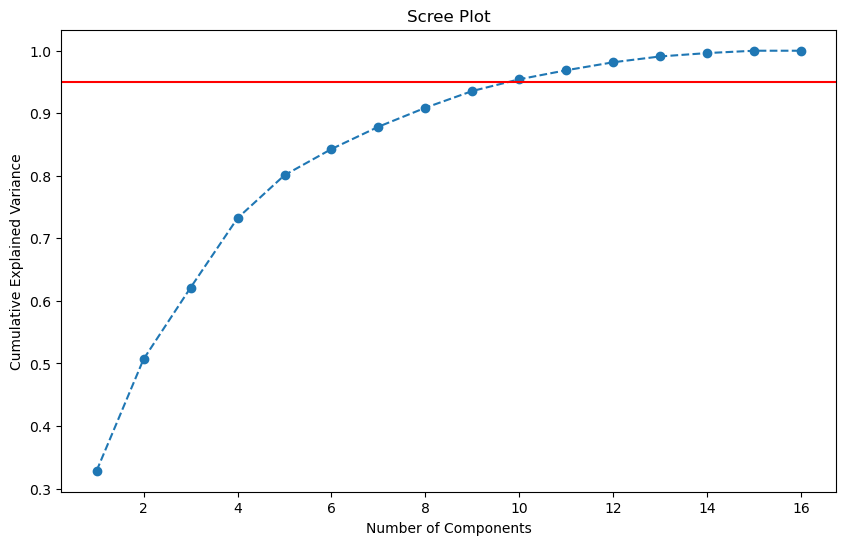

In [61]:
# Use the before selected standardized numeric columns for the pca
pca = PCA().fit(standardized_data)

# Get the cummulative sum of explained variance per pc
explained_variance = np.cumsum(pca.explained_variance_ratio_)

# Plot it with a horizontal line at 95% variance explained 
plt.figure(figsize=(10, 6))
plt.plot(range(1, len(explained_variance) + 1), explained_variance, marker='o', linestyle='--')
plt.xlabel('Number of Components')
plt.ylabel('Cumulative Explained Variance')
plt.title('Scree Plot')
plt.axhline(y=0.95, color='r', linestyle='-')
plt.show()

10 components seem to be necessary to capture a variance of 95%.

#### 4.c.ii Analyse the feature importance within PCs

The orthogonal (uncorrelated) principal components capture a decreasing amount of variance.

Therefore PC1 is displayed exemplarily here.

They can be interpreted as linear combinations of the original features.


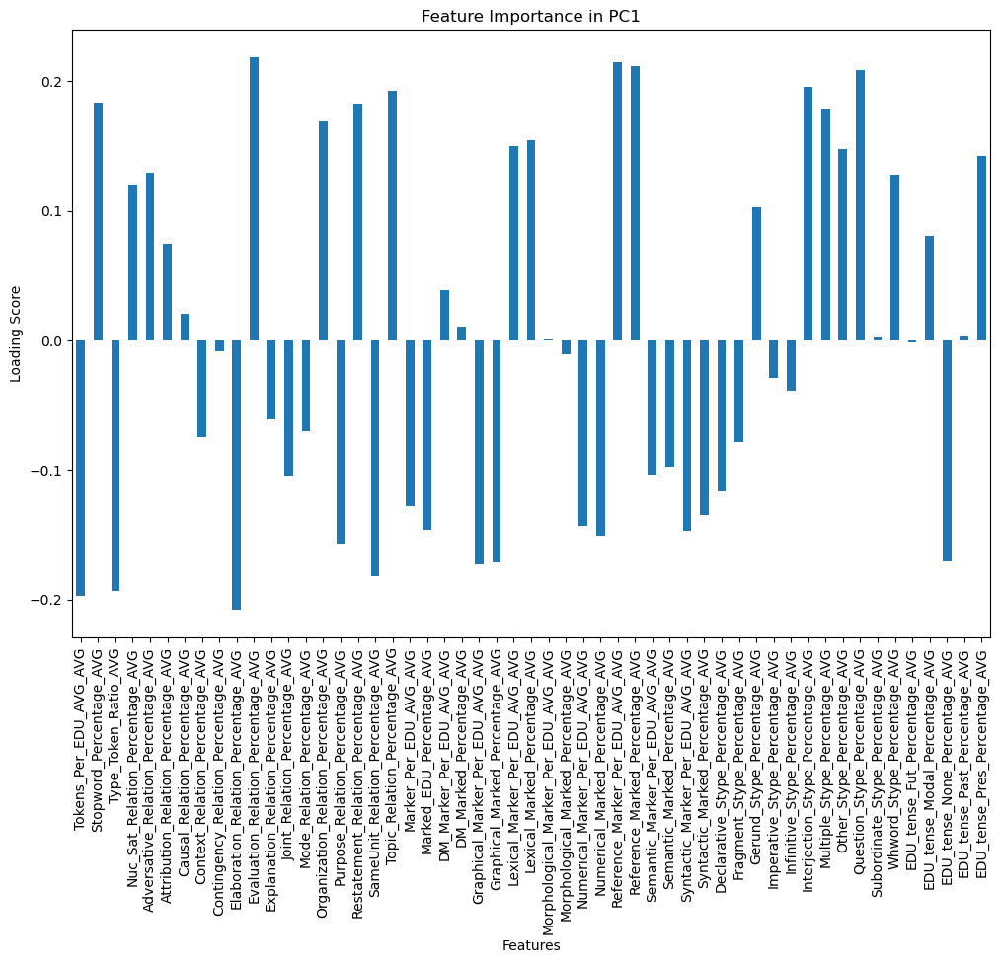

In [63]:
# Get the loadings for the first principal component
loadings = pd.DataFrame(pca.components_.T, columns=[f'PC{i+1}' for i in range(len(pca.components_))], index=standardized_genre_df.columns[1:])

# Plot the loadings for the first few principal components
plt.figure(figsize=(12, 8))
loadings['PC1'].plot(kind='bar')
plt.title('Feature Importance in PC1')
plt.xlabel('Features')
plt.ylabel('Loading Score')
plt.show()


#### 4.c.iii Apply the PCA with 10 components

In [64]:
# Apply PCA
pca = PCA(n_components=10) 
pca_result = pca.fit_transform(standardized_data)

## 5. Cluster Genres

### 5.a K-Means

#### 5.a.i Decide for an amount of groups with the elbow criteria

C:\Users\marco\AppData\Roaming\Python\Python312\site-packages\sklearn\cluster\_kmeans.py:1411: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\marco\AppData\Roaming\Python\Python312\site-packages\sklearn\cluster\_kmeans.py:1411: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\marco\AppData\Roaming\Python\Python312\site-packages\sklearn\cluster\_kmeans.py:1411: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\marco\AppData\Roaming\Python\Python312\site-packages\sklearn\cluster\_

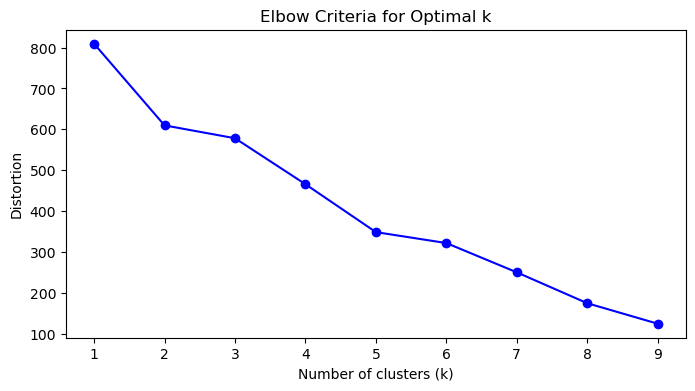

In [65]:
# Determine optimal number of clusters using the elbow criteria
distortions = []
K = range(1, 10)
for k in K:
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(pca_result)
    distortions.append(kmeans.inertia_)

# Plot the distortions
plt.figure(figsize=(8, 4))
plt.plot(K, distortions, 'bo-')
plt.xlabel('Number of clusters (k)')
plt.ylabel('Distortion')
plt.title('Elbow Criteria for Optimal k')
plt.show()

The distortion sharply decreases after k=4 and then somewhat levels. We go with k=5 as the leveling between k=2 and k=3 is only short lived.

#### 5.a.ii Fit K-Means

In [81]:
# Fit K-Means model
kmeans = KMeans(n_clusters=5, random_state=42)
kmeans.fit(pca_result)

# Add cluster labels to DataFrame
standardized_genre_df['K-Means-Clusters'] = kmeans.labels_

standardized_genre_df[['Genre', 'K-Means-Clusters']]

C:\Users\marco\AppData\Roaming\Python\Python312\site-packages\sklearn\cluster\_kmeans.py:1411: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


,Genre,K-Means-Clusters
0,academic,1
1,bio,0
2,conversation,2
3,court,3
4,essay,3
5,fiction,0
6,interview,1
7,letter,1
8,news,1
9,podcast,3


#### 5.a.iii Visualize the clusters using t-SNE

We choose the **t-Distributed Stochastic Neighbor Embedding (t-SNE):** as it is particularly good at preserving the local structure and makes sure that similar data points are close to each other in the lower-dimensional space. t-SNE often creates well-separated clusters in the lower-dimensional space, making it a reasonable choice for visualizing high-dimensional data (our pca results).

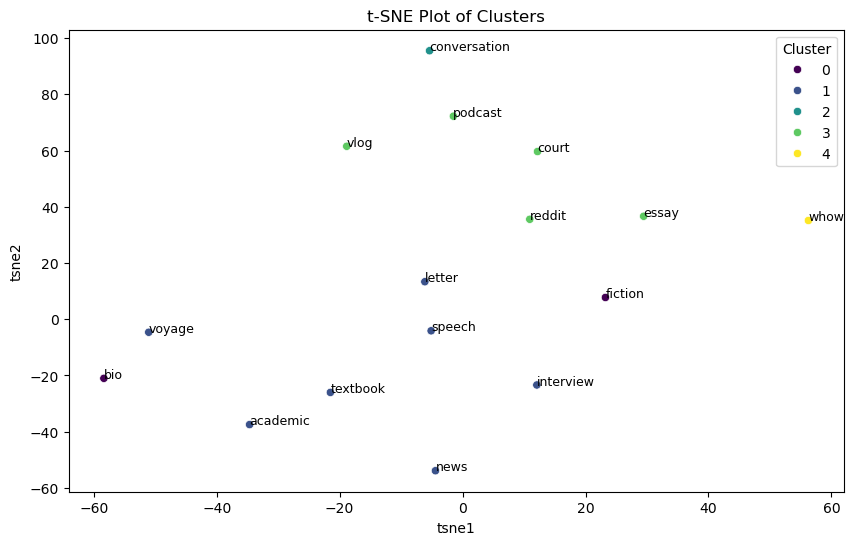

In [76]:
# Visualize clusters using t-SNE
tsne = TSNE(n_components=2, perplexity=6, random_state=42)
tsne_result = tsne.fit_transform(pca_result)
standardized_genre_df['tsne1'] = tsne_result[:, 0]
standardized_genre_df['tsne2'] = tsne_result[:, 1]

# Plot it
plt.figure(figsize=(10, 6))
sns.scatterplot(x='tsne1', y='tsne2', hue='Cluster', data=standardized_genre_df, palette='viridis')
# Add annotations
for i in range(standardized_genre_df.shape[0]):
    plt.text(standardized_genre_df['tsne1'][i], standardized_genre_df['tsne2'][i], standardized_genre_df['Genre'][i], fontsize=9)
plt.title('t-SNE Plot of Clusters')
plt.show()

### 5.b Spectral Clustering

In [ ]:
# Spectral Clustering using PCA results
spectral = SpectralClustering(n_clusters=3, affinity='nearest_neighbors', random_state=42).fit(pca_result)
labels = spectral.labels_

# Adding cluster labels to the DataFrame
standardized_genre_df['Spectral-Clusters'] = labels
standardized_genre_df[['Genre', 'Spectral-Clusters']]


C:\Users\marco\AppData\Roaming\Python\Python312\site-packages\sklearn\cluster\_kmeans.py:1411: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


,Genre,Spectral-Clusters
0,academic,1
1,bio,1
2,conversation,0
3,court,2
4,essay,2
5,fiction,0
6,interview,2
7,letter,2
8,news,1
9,podcast,0


### 5.c Gaussian Mixture Models (GMM)

In [84]:
# GMM using PCA results
gmm = GaussianMixture(n_components=3, random_state=42).fit(pca_result)
labels = gmm.predict(pca_result)

# Adding cluster labels to the DataFrame
standardized_genre_df['GMM-Clusters'] = labels
standardized_genre_df[['Genre', 'GMM-Clusters']]


C:\Users\marco\AppData\Roaming\Python\Python312\site-packages\sklearn\cluster\_kmeans.py:1411: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


,Genre,GMM-Clusters
0,academic,1
1,bio,0
2,conversation,2
3,court,1
4,essay,1
5,fiction,0
6,interview,1
7,letter,1
8,news,1
9,podcast,2


### 5.d Hierachical Clustering

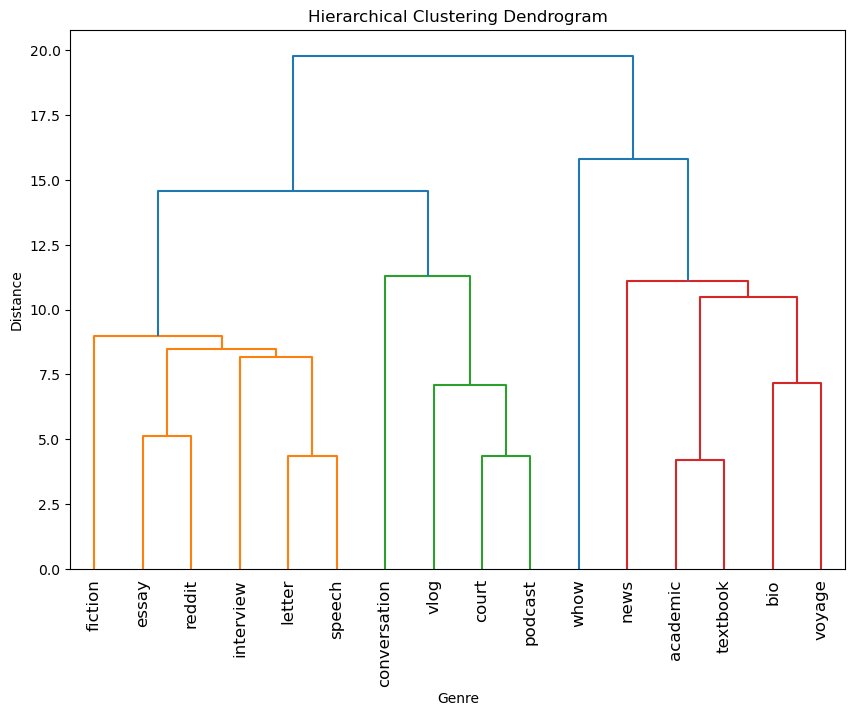

In [79]:
# Hierarchical Clustering using PCA results
Z = linkage(pca_result, 'ward')

# Plotting the dendrogram
plt.figure(figsize=(10, 7))
dendrogram(Z, labels=standardized_genre_df['Genre'].values, leaf_rotation=90)
plt.title('Hierarchical Clustering Dendrogram')
plt.xlabel('Genre')
plt.ylabel('Distance')
plt.show()
